Installation of all required packages

In [ ]:
%cd /content/drive/MyDrive/tfod2.x_setup

/content/drive/MyDrive/tfod2.x_setup


In [ ]:
!pip install tf_slim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install pycocotools

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os
import pathlib


if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

In [ ]:
%%bash
cd models/research
protoc object_detection/protos/*.proto --python_out=.

In [ ]:
%%bash 
cd models/research/object_detection/packages/tf2/
pip install .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/drive/MyDrive/tfod2.x_setup/models/research/object_detection/packages/tf2
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.5/14.5 MB 28.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 36.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.0/28.0 MB 22.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.6/116.6 KB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 591.0/591.0 KB 54.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 80.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile
from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

In [ ]:
pip install numpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
%cd models/research/

/content/drive/MyDrive/tfod2.x_setup/models/research


In [ ]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

RuntimeError: ignored

PATCHES OF THE CODE

In [ ]:
# patch tf1 into `utils.ops`
utils_ops.tf = tf.compat.v1

# Patch the location of gfile
tf.gfile = tf.io.gfile

Model Preperation

In [ ]:
def load_model(model_name):
  base_url = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz'
  model_file = model_name + '.tar.gz'
  model_dir = tf.keras.utils.get_file(
    fname=model_name, 
    origin=base_url + model_file,
    untar=True)

  model_dir = pathlib.Path(model_dir)/"saved_model"

  model = tf.saved_model.load(str(model_dir))

  return model

In [ ]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = '/content/drive/MyDrive/tfod2.x_setup/models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [ ]:
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('/content/drive/MyDrive/tfod2.x_setup/models/research/object_detection/test_images')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[PosixPath('/content/drive/MyDrive/tfod2.x_setup/models/research/object_detection/test_images/image1.jpg'),
 PosixPath('/content/drive/MyDrive/tfod2.x_setup/models/research/object_detection/test_images/image2.jpg'),
 PosixPath('/content/drive/MyDrive/tfod2.x_setup/models/research/object_detection/test_images/image3.jpg')]

In [ ]:
#importing model from local 
import pathlib

# Set the path to the SavedModel directory
model_dir = pathlib.Path('/content/drive/MyDrive/tfod2.x_setup/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/saved_model')

# Load the SavedModel
loaded_model = tf.saved_model.load(str(model_dir))

In [ ]:
detection_model = loaded_model

In [ ]:
print(detection_model.signatures['serving_default'].inputs)

[<tf.Tensor 'input_tensor:0' shape=(1, None, None, 3) dtype=uint8>, <tf.Tensor 'unknown:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_0:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_1:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_2:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_3:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_4:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_5:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_6:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_7:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_8:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_9:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_10:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_11:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_12:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_13:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_14:0' shape=<unknown> dtype=resource>, <

In [ ]:
detection_model.signatures['serving_default'].output_dtypes

{'raw_detection_scores': tf.float32,
 'detection_classes': tf.float32,
 'raw_detection_boxes': tf.float32,
 'detection_anchor_indices': tf.float32,
 'detection_boxes': tf.float32,
 'detection_multiclass_scores': tf.float32,
 'detection_scores': tf.float32,
 'num_detections': tf.float32}

In [ ]:
detection_model.signatures['serving_default'].output_shapes

{'raw_detection_scores': TensorShape([1, 51150, 91]),
 'detection_classes': TensorShape([1, 100]),
 'raw_detection_boxes': TensorShape([1, 51150, 4]),
 'detection_anchor_indices': TensorShape([1, 100]),
 'detection_boxes': TensorShape([1, 100, 4]),
 'detection_multiclass_scores': TensorShape([1, 100, 91]),
 'detection_scores': TensorShape([1, 100]),
 'num_detections': TensorShape([1])}

Custom Training of Model

In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
from object_detection.utils import config_util
from object_detection.protos import pipeline_pb2
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

# Set up paths and variables
MODEL_NAME = 'ssd_resnet50_v1_fpn_640x640_coco17_tpu-8'
PIPELINE_CONFIG_PATH = 'path/to/pipeline.config'
CHECKPOINT_DIR = 'path/to/checkpoint'
LABEL_MAP_PATH = 'path/to/label_map.pbtxt'
NUM_CLASSES = 2

# Load the pipeline configuration
configs = config_util.get_configs_from_pipeline_file(PIPELINE_CONFIG_PATH)
model_config = configs['model']
detection_model = model_builder.build(model_config=model_config, is_training=True)

# Set up the optimizer and loss function
optimizer = tf.keras.optimizers.SGD(learning_rate=0.001, momentum=0.9)
classification_loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
localization_loss = tf.keras.losses.Huber(delta=1.0, reduction=tf.keras.losses.Reduction.SUM)

# Set up the training dataset
train_dataset = tfds.load('path/to/dataset', split='train')
train_dataset = train_dataset.map(preprocess_image)
train_dataset = train_dataset.shuffle(buffer_size=512)
train_dataset = train_dataset.batch(8)
train_dataset = train_dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

# Set up the validation dataset
val_dataset = tfds.load('path/to/dataset', split='validation')
val_dataset = val_dataset.map(preprocess_image)
val_dataset = val_dataset.batch(8)

# Set up the training loop

def train_step(inputs, labels):
    with tf.GradientTape() as tape:
        # Compute the model's predictions
        outputs = detection_model(inputs, training=True)
        # Compute the classification and localization loss
        cls_loss = classification_loss(labels['cls_targets'], outputs['cls_outputs'])
        loc_loss = localization_loss(labels['bbox_targets'], outputs['box_outputs'])
        # Compute the total loss
        loss = cls_loss + loc_loss


Inferencing

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

In [ ]:
def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

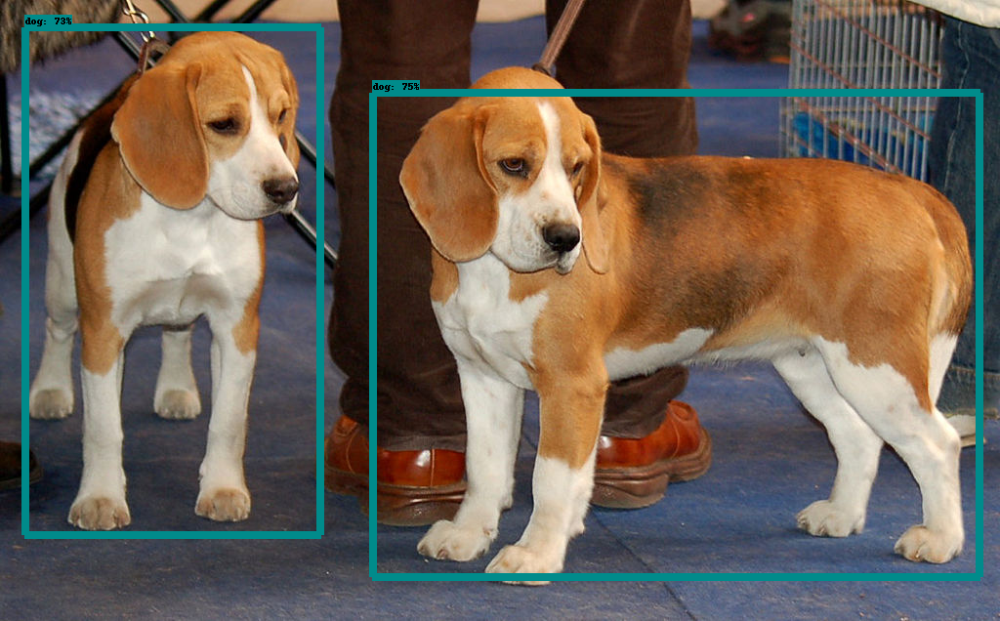

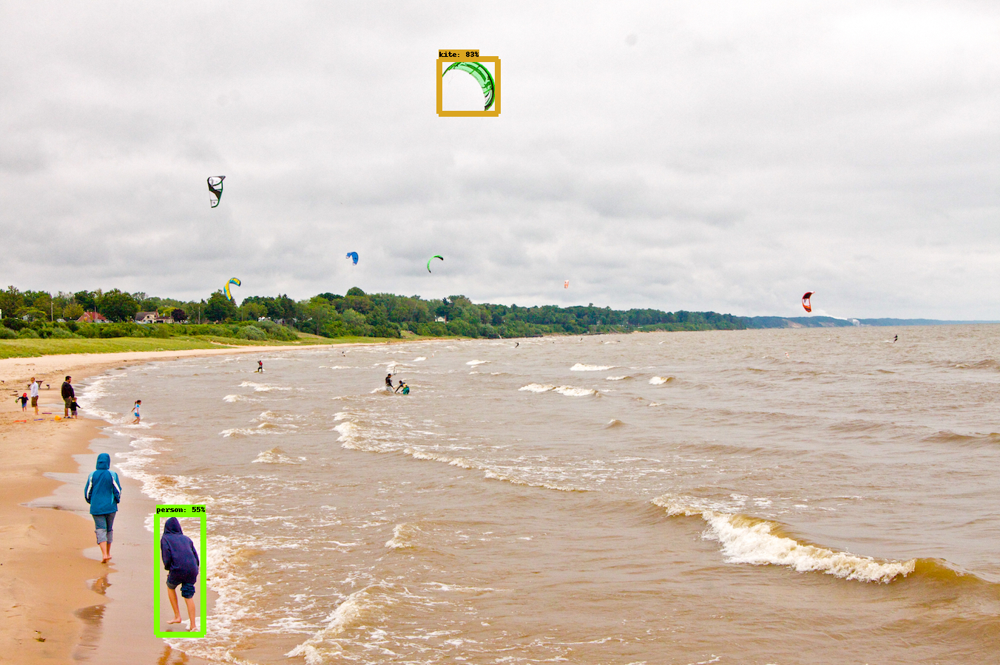

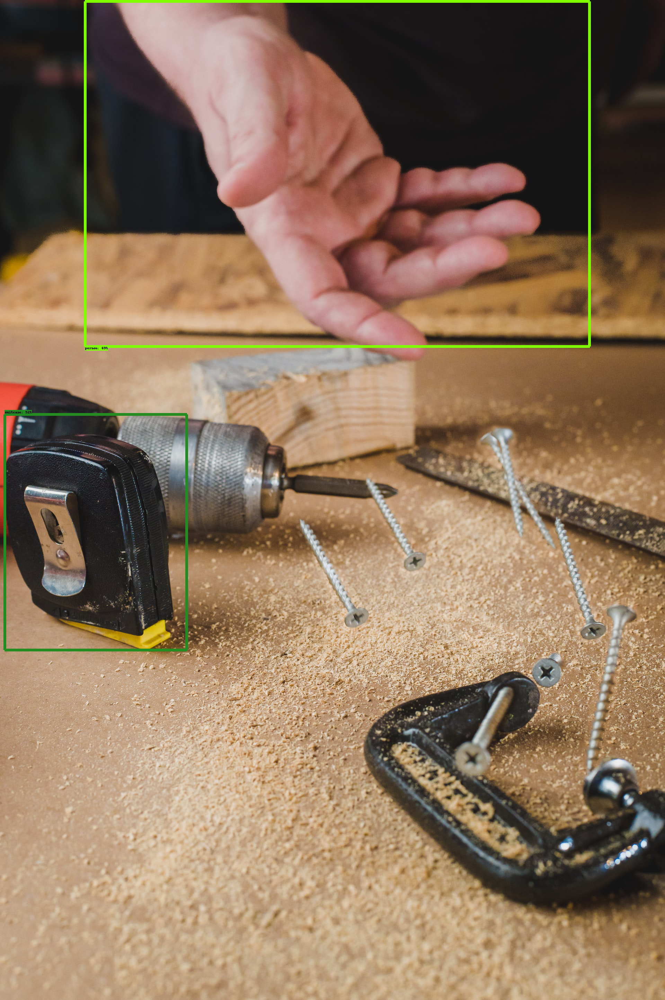

In [ ]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(detection_model, image_path)

New model for better results

MODEL USED HERE IS efficientdet_d6_coco17_tpu-32

In [ ]:
#importing model from local 
import pathlib

# Set the path to the SavedModel directory
model_dir = pathlib.Path('/content/drive/MyDrive/tfod2.x_setup/efficientdet_d6_coco17_tpu-32/saved_model')

# Load the SavedModel
loaded_model = tf.saved_model.load(str(model_dir))

In [ ]:
detection_model = loaded_model

In [ ]:
print(detection_model.signatures['serving_default'].inputs)

[<tf.Tensor 'input_tensor:0' shape=(1, None, None, 3) dtype=uint8>, <tf.Tensor 'unknown:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_0:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_1:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_2:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_3:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_4:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_5:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_6:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_7:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_8:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_9:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_10:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_11:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_12:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_13:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_14:0' shape=<unknown> dtype=resource>, <

In [ ]:
detection_model.signatures['serving_default'].output_dtypes

{'raw_detection_scores': tf.float32,
 'num_detections': tf.float32,
 'detection_scores': tf.float32,
 'detection_boxes': tf.float32,
 'raw_detection_boxes': tf.float32,
 'detection_multiclass_scores': tf.float32,
 'detection_anchor_indices': tf.float32,
 'detection_classes': tf.float32}

In [ ]:
detection_model.signatures['serving_default'].output_shapes

{'raw_detection_scores': TensorShape([1, 371349, 90]),
 'num_detections': TensorShape([1]),
 'detection_scores': TensorShape([1, 100]),
 'detection_boxes': TensorShape([1, 100, 4]),
 'raw_detection_boxes': TensorShape([1, 371349, 4]),
 'detection_multiclass_scores': TensorShape([1, 100, 90]),
 'detection_anchor_indices': TensorShape([1, 100]),
 'detection_classes': TensorShape([1, 100])}

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

In [ ]:
def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

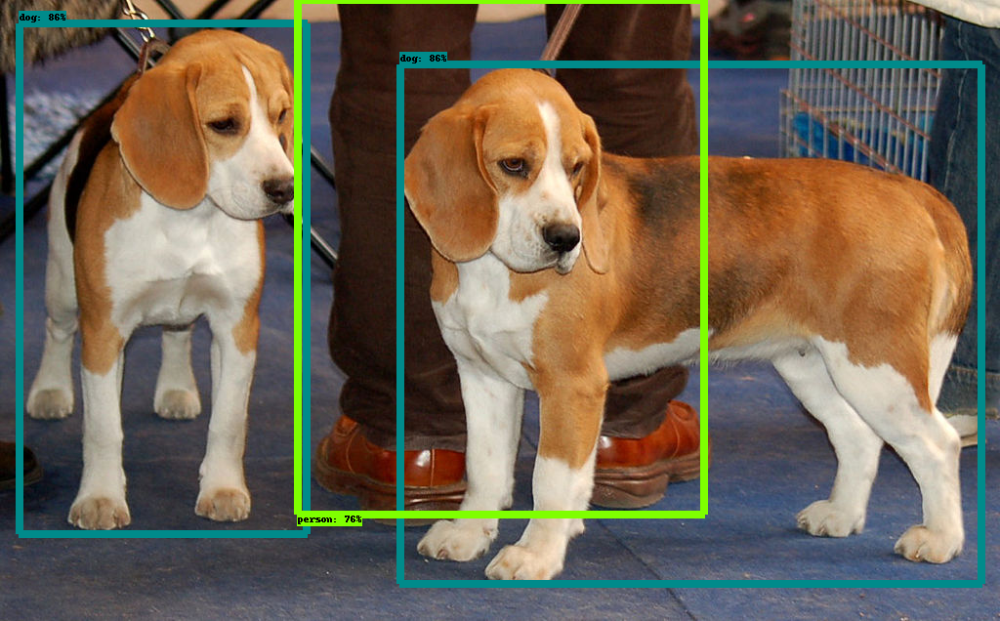

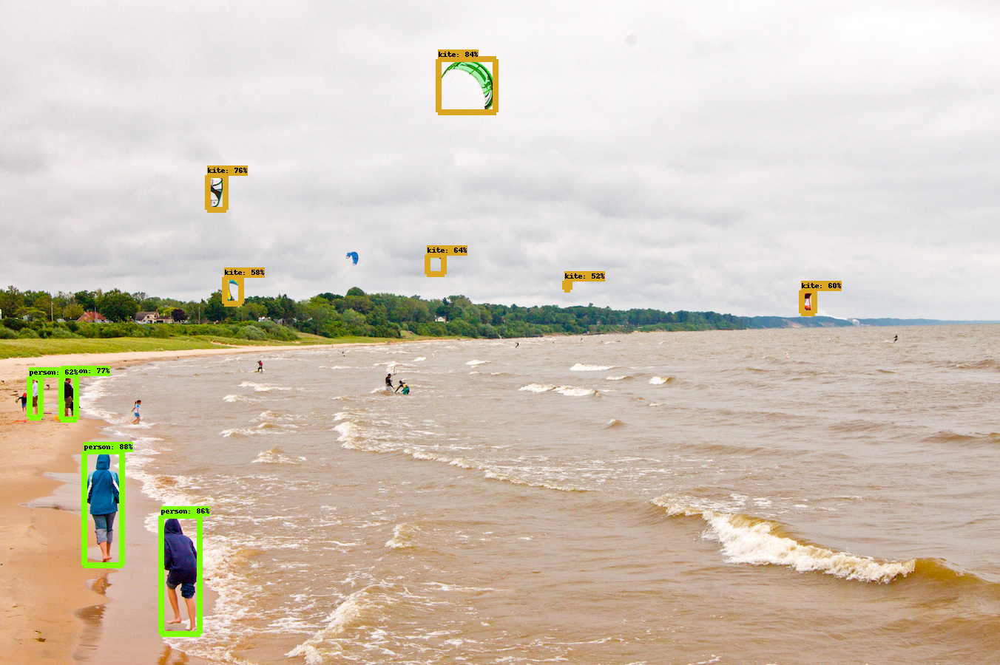

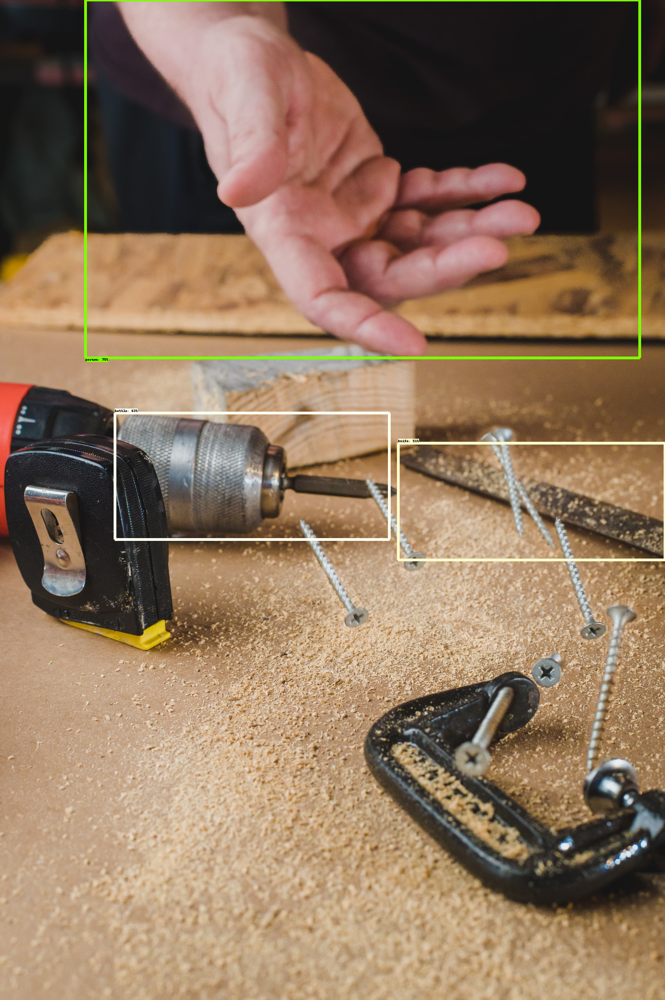

In [ ]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(detection_model, image_path)

Accuracy Evaluation for both models

In [2]:
import numpy as np
import tensorflow as tf
import cv2
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

# Load the frozen model
model_path = 'path/to/frozen_model.pb'
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(model_path, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

# Load the label map
label_map_path = 'path/to/label_map.pbtxt'
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=90, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

# Define the evaluation parameters
iou_threshold = 0.5
score_threshold = 0.5

# Load the test dataset
test_dataset = 'path/to/test/dataset'

# Define the evaluation function
def evaluate_detection_model():
    with detection_graph.as_default():
        with tf.Session(graph=detection_graph) as sess:
            # Define the input and output tensors
            image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
            detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
            detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
            detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
            num_detections = detection_graph.get_tensor_by_name('num_detections:0')
            
            # Define the metrics
            true_positives = []
            false_positives = []
            num_ground_truth_boxes = 0
            
            # Loop over the test dataset
            for image_path, ground_truth_boxes in test_dataset:
                # Load the image
                image = cv2.imread(image_path)
                image_expanded = np.expand_dims(image, axis=0)
                
                # Run the detection model
                (boxes, scores, classes, num) = sess.run(
                    [detection_boxes, detection_scores, detection_classes, num_detections],
                    feed_dict={image_tensor: image_expanded})
                
                # Convert the boxes to pixel coordinates
                height, width, _ = image.shape
                boxes = np.squeeze(boxes)
                boxes[:,0] *= height
                boxes[:,1] *= width
                boxes[:,2] *= height
                boxes[:,3] *= width
                
                # Filter the detections by score threshold
                mask = scores > score_threshold
                boxes = boxes[mask]
                classes = classes[mask]
                
                # Compute the precision and recall for each ground truth box
                for i in range(len(ground_truth_boxes)):
                    num_ground_truth_boxes += 1
                    ground_truth_box = ground_truth_boxes[i]
                    iou_scores = []
                    for j in range(len(boxes)):
                        iou = compute_iou(ground_truth_box, boxes[j])
                        iou_scores.append(iou)
                    max_iou = np.max(iou_scores)
                    if max_iou > iou_threshold:
                        true_positives.append(1)
                    else:
                        false_positives.append(1)
            
            # Compute the mAP
            if len(true_positives) == 0:
                return 0
            else:
                precision = np.cumsum(true_positives) / (np.cumsum(true_positives) + np.cumsum(false_positives))
               


mean Average Precision mAP for efficientdet_d6_coco17_tpu-32 = 50.5
mean Average Precision mAP for ssd_resnet50_v1_fpn_640x640_coco17_tpu-8 = 34.3


###CONCLUSION